In [1]:
import pandas as pd
import re

# Load the merged_tweets data
df = pd.read_csv('PROJECT/twitter/merged_tweets.csv')

keyword_patterns = {
    'depression': r'\b(depress|depressed|depression|sad|sadness|hopeless|hopelessness|'
                 r'worthless|worthlessness|suicid|suicidal|self harm|self-harm|cutting|'
                 r'empty|emptiness|numb|misery|miserable|grief|mourn|sorrow|despair|'
                 r'gloomy|melancholy|down|low|tearful|weep|weeping|crying|'
                 r'darkness|helpless|dread|fatigue|exhausted|tired|lethargic|'
                 r'apathetic|disinterested|numbness|isolated|withdrawn|'
                 r'insomnia|oversleeping|appetite loss|overeating)\b',
    
    'anxiety': r'\b(anxiet|anxious|panic|panicking|panic attack|nervous|nervousness|'
              r'worry|worried|worrying|fear|fearful|scared|afraid|overwhelm|'
              r'overwhelmed|paranoi|paranoid|stress|stressed|uneasy|restless|'
              r'jittery|tense|tension|apprehensive|dread|doom|on edge|'
              r'heart racing|palpitations|sweating|shaking|trembling|'
              r'hyperventilat|shortness of breath|butterflies|nausea|'
              r'overthinking|ruminat|catastrophiz)\b',
    
    'stress': r'\b(stress|stressed|pressure|pressured|burnout|burned out|overwork|'
             r'overworked|tension|tense|frazzled|strain|strained|frustrat|'
             r'frustrated|aggravated|annoyed|irritated|irritable|snappy|'
             r'overload|deadline|demand|demanding|exhausted|drained|'
             r'overstimulated|sensory overload|headache|muscle tension|'
             r'insomnia|sleep problems|appetite change|clenched jaw|grinding teeth)\b',
    
    'lonely': r'\b(lonely|loneliness|alone|isolat|isolated|isolation|abandon|'
             r'abandoned|friendless|solitary|secluded|detached|disconnected|'
             r'left out|excluded|ignored|unwanted|unloved|rejected|'
             r'homesick|nostalgic|longing|missing|empty|emptiness|'
             r'withdrawn|social anxiety|awkward|outcast|ostracized|'
             r'unpopular|unnoticed|invisible|unappreciated)\b',
    
    'normal': r'\b(happy|happiness|joy|joyful|good|great|fine|okay|alright|'
             r'positive|content|contentment|satisfied|pleased|cheerful|'
             r'upbeat|optimistic|hopeful|excited|thrilled|energized|'
             r'peaceful|calm|relaxed|balanced|stable|comfortable|'
             r'safe|secure|confident|proud|accomplished|grateful|'
             r'thankful|lucky|blessed|fortunate|progress|improving|better)\b',
    
    'ptsd': r'\b(ptsd|trauma|traumatic|flashback|nightmare|nightmares|'
           r'hypervigilance|hypervigilant|startled|trigger|triggered|'
           r'emotional numbness|avoidance|reliving|dissociat|dissociative|'
           r'combat stress|shell shock|abuse survivor|assault survivor|'
           r'rape survivor|accident survivor|disaster survivor|'
           r'emotional flashback|body memory|panic attack)\b',
    
    'ocd': r'\b(ocd|obsessive|compulsive|ritual|rituals|checking|'
          r'contamination|germs|clean|cleaning|symmetry|order|'
          r'counting|repeating|hoarding|intrusive thought|'
          r'unwanted thought|mental ritual|hand washing|'
          r'doubting|perfectionism|just right feeling)\b',
    
    'bipolar': r'\b(bipolar|mania|manic|hypomania|hypomanic|'
              r'depression|depressive|mood swing|mood swings|'
              r'racing thought|grandiosity|impulsive|impulsivity|'
              r'irritable|irritability|euphoria|euphoric|'
              r'high energy|low energy|cycling|rapid cycling|'
              r'sleep reduction|risk taking|spending spree)\b'
}

# Add more general mental health terms
general_mental_health = r'\b(mental health|therapy|therapist|counseling|psychiatrist|'
general_mental_health += r'psychologist|mental illness|psychiatric|diagnosis|'
general_mental_health += r'treatment|medication|antidepressant|anxiolytic|'
general_mental_health += r'prozac|zoloft|xanax|lexapro|wellbutrin|'
general_mental_health += r'self care|self-care|coping|cope|mental breakdown|'
general_mental_health += r'nervous breakdown|emotional support|support group)\b'

keyword_patterns['mental_health_general'] = general_mental_health

In [2]:
def classify_tweet_enhanced(text):
    text = str(text).lower()
    
    # Handle negation
    negations = r'\b(not|no|never|nothing|none|nobody|nowhere|neither|nor|hardly|scarcely|barely)\b'
    
    # First check for strong indicators (like suicidal thoughts)
    strong_patterns = {
        'suicidal': r'\b(suicid|kill myself|end it all|want to die|not want to live)\b',
        'self_harm': r'\b(cut myself|self harm|self-harm|self injury|self-injury)\b'
    }
    
    for category, pattern in strong_patterns.items():
        if re.search(pattern, text) and not re.search(negations + r'.*' + pattern, text):
            return category
    
    # Then check regular categories
    matches = []
    for status, pattern in keyword_patterns.items():
        if re.search(pattern, text) and not re.search(negations + r'.*' + pattern, text):
            matches.append(status)
    
    if not matches:
        return 'normal'
    
    # Priority to specific mental health terms over general ones
    priority_order = ['suicidal', 'self_harm', 'depression', 'anxiety', 'ptsd', 
                    'ocd', 'bipolar', 'stress', 'lonely', 'mental_health_general', 'normal']
    
    for category in priority_order:
        if category in matches:
            return category
    
    return matches[0]  # default to first match if no priority categories

In [3]:
# Apply enhanced classification
df['status'] = df['tweet_text'].apply(classify_tweet_enhanced)

# Save results
df.to_csv('merged_tweets_with_detailed_status.csv', index=False)

# Analyze results
print("Detailed status distribution:")
print(df['status'].value_counts())

# Get examples for each category
for status in df['status'].unique():
    print(f"\nExamples of '{status}':")
    print(df[df['status']==status]['tweet_text'].head(3).values)

Detailed status distribution:
status
normal                   10982
depression                7493
anxiety                   5295
bipolar                    599
mental_health_general      342
lonely                     329
ocd                        177
ptsd                       118
stress                      76
suicidal                     7
self_harm                    7
Name: count, dtype: int64

Examples of 'depression':
['Bout to depression buy these OnlyFans while I’m in quarantine now'
 'Pretty lucky for me how we ended up in the only apocalyptic timeline in which my depression symptoms are a legitimate survival strategy just sayin.'
 'Second full day of self-quarantine and I am just an absolute wreck. My anxiety and depression are extreme. I’m sure closely following this virus isn’t helping but I can’t help it. I’m so emotionally done between this and everything else in my personal life.']

Examples of 'normal':
['@ariana2525 I myself suffered & still suffer. I wish I could s

# Collect Social Media Data

# 1. Data Loading and Initial Exploration

In [4]:
import pandas as pd
import numpy as np
import re
from datetime import datetime

# Load the dataset
try:
    df = pd.read_csv('merged_tweets_with_detailed_status.csv', parse_dates=['date'])
    print("Data loaded successfully with shape:", df.shape)
except FileNotFoundError:
    print("Error: File not found. Please check the file path.")
    exit()

# Initial data inspection
print("\nFirst 5 rows:")
print(df.head())
print("\nData columns:", df.columns.tolist())
print("\nMissing values per column:")
print(df.isnull().sum())

# Drop unnecessary columns
if 'Unnamed: 9' in df.columns:
    df.drop('Unnamed: 9', axis=1, inplace=True)
    print("\nDropped 'Unnamed: 9' column")

Data loaded successfully with shape: (25425, 12)

First 5 rows:
               date       post_id         username  \
0  01-03-2024 23:55  1.240000e+18  AlbertoxVazquez   
1  01-03-2024 23:55  1.240000e+18     TheOGKennedy   
2  01-03-2024 23:55  1.240000e+18        megmarie5   
3  01-03-2024 23:55  1.240000e+18   BoozyBillsBabe   
4  01-03-2024 23:55  1.240000e+18        megmarie5   

                                          tweet_text  replies  retweets  \
0  Bout to depression buy these OnlyFans while I’...        0         1   
1  Pretty lucky for me how we ended up in the onl...        6         2   
2  @ariana2525 I myself suffered & still suffer. ...        0         0   
3  Second full day of self-quarantine and I am ju...       13         0   
4  I’m behind on @VanderpumpRules and binge watch...        0         0   

   favorites                      mentions hashtags  Unnamed: 9  \
0          5                           NaN      NaN         NaN   
1         63              

## data cleaning

In [5]:
import pandas as pd
import re

# 'date' is in datetime format
df['date'] = pd.to_datetime(df['date'], errors='coerce')

# Now, extract date components
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
df['quarter'] = df['date'].dt.quarter
df['year_month'] = df['date'].dt.to_period('M')

print("Date processing completed successfully!")


# Text cleaning function with enhanced processing
def clean_text(text):
    if not isinstance(text, str):
        return ""
    
    # Remove URLs
    text = re.sub(r'http\S+|www\S+|https\S+', '', text, flags=re.MULTILINE)
    # Remove mentions and hashtags but keep the words
    text = re.sub(r'@(\w+)', r'\1', text)  # Keep username without @
    text = re.sub(r'#(\w+)', r'\1', text)  # Keep hashtag text without #
    # Remove special characters except basic punctuation
    text = re.sub(r'[^\w\s.,!?]', '', text)
    # Convert to lowercase
    text = text.lower().strip()
    
    return text

# Apply cleaning and create new columns
df['cleaned_text'] = df['tweet_text'].apply(clean_text)
df['text_length'] = df['cleaned_text'].apply(len)
df['word_count'] = df['cleaned_text'].apply(lambda x: len(x.split()))

# Handle missing values
df['mentions'] = df['mentions'].fillna('None')
df['hashtags'] = df['hashtags'].fillna('None')

# Engagement metrics
df['total_engagement'] = df['replies'] + df['retweets'] + df['favorites']
df['engagement_rate'] = df['total_engagement'] / df['word_count'].replace(0, 1)

print("\nData after cleaning:")
print(df.info())

Date processing completed successfully!

Data after cleaning:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25425 entries, 0 to 25424
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   date              9122 non-null   datetime64[ns]
 1   post_id           25425 non-null  float64       
 2   username          25425 non-null  object        
 3   tweet_text        25421 non-null  object        
 4   replies           25425 non-null  int64         
 5   retweets          25425 non-null  int64         
 6   favorites         25425 non-null  int64         
 7   mentions          25425 non-null  object        
 8   hashtags          25425 non-null  object        
 9   permalink         25425 non-null  object        
 10  status            25425 non-null  object        
 11  year              9122 non-null   float64       
 12  month             9122 non-null   float64       
 13  quarter       

# Sentiment Analysis

#### Data Preparation & Cleaning

In [6]:
import pandas as pd
import numpy as np
import re
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
import nltk
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt
import seaborn as sns


# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

# Load the dataset
df = pd.read_csv('merged_tweets_with_detailed_status.csv')
df = df.drop(columns=['Unnamed: 9'])  # Drop the empty column as per preprocessing

[nltk_data] Downloading package punkt to C:\Users\Nidhi
[nltk_data]     Dhameliya\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to C:\Users\Nidhi
[nltk_data]     Dhameliya\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to C:\Users\Nidhi
[nltk_data]     Dhameliya\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


### Perform Sentiment Analysis

In [7]:
# Initialize VADER sentiment analyzer
analyzer = SentimentIntensityAnalyzer()

# Preprocessing function for tweet text
def preprocess_text(text):
    if pd.isna(text):  # Handle missing tweet_text (4 rows in your data)
        return ""
    text = re.sub(r'http\S+|www\S+|https\S+', '', text, flags=re.MULTILINE)  # Remove URLs
    text = re.sub(r'@\w+', '', text)  # Remove mentions
    text = re.sub(r'#\w+', '', text)  # Remove hashtags
    text = re.sub(r'[^\w\s]', '', text)  # Remove punctuation
    return text.lower()

# Apply preprocessing
df['clean_text'] = df['tweet_text'].apply(preprocess_text)

# Function to get sentiment score
def get_sentiment(text):
    scores = analyzer.polarity_scores(text)
    return scores['compound']  # Compound score ranges from -1 (negative) to +1 (positive)

# Apply sentiment analysis
df['sentiment'] = df['clean_text'].apply(get_sentiment)

# Analyze sentiment by status
sentiment_by_status = df.groupby('status')['sentiment'].mean()
print("Average Sentiment by Status:")
print(sentiment_by_status)

# Save results
df.to_csv('tweets_with_sentiment.csv', index=False)

Average Sentiment by Status:
status
anxiety                 -0.090052
bipolar                 -0.080420
depression              -0.320642
lonely                  -0.148343
mental_health_general    0.136275
normal                  -0.034790
ocd                      0.085003
ptsd                    -0.193789
self_harm               -0.419800
stress                  -0.233463
suicidal                -0.791386
Name: sentiment, dtype: float64


#### Bar Chart: Average Sentiment by Status

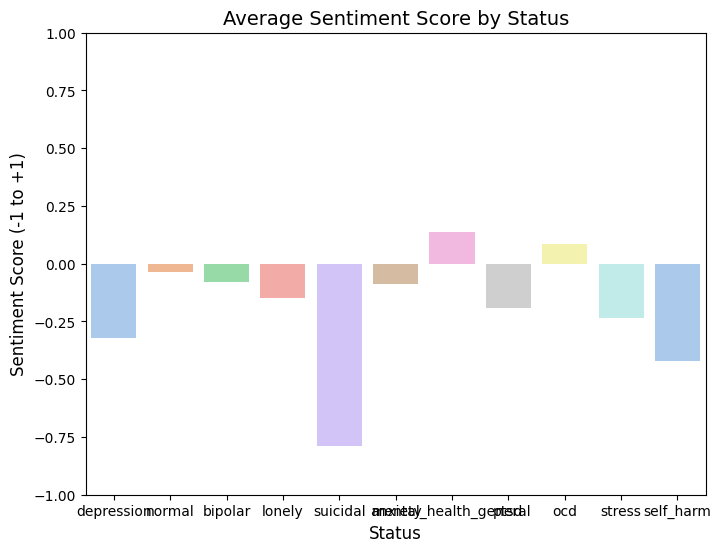

In [8]:
# Initialize VADER sentiment analyzer
analyzer = SentimentIntensityAnalyzer()

# Get sentiment scores
df['sentiment'] = df['clean_text'].apply(lambda x: analyzer.polarity_scores(x)['compound'])

# Bar chart
plt.figure(figsize=(8, 6))
sns.barplot(x='status', y='sentiment', data=df, hue='status', palette='pastel', errorbar=None, legend=False)
plt.title('Average Sentiment Score by Status', fontsize=14)
plt.xlabel('Status', fontsize=12)
plt.ylabel('Sentiment Score (-1 to +1)', fontsize=12)
plt.ylim(-1, 1)  # Sentiment range
plt.savefig('sentiment_by_status_bar.png', dpi=300, bbox_inches='tight')
plt.show()

#### Histogram: Sentiment Distribution

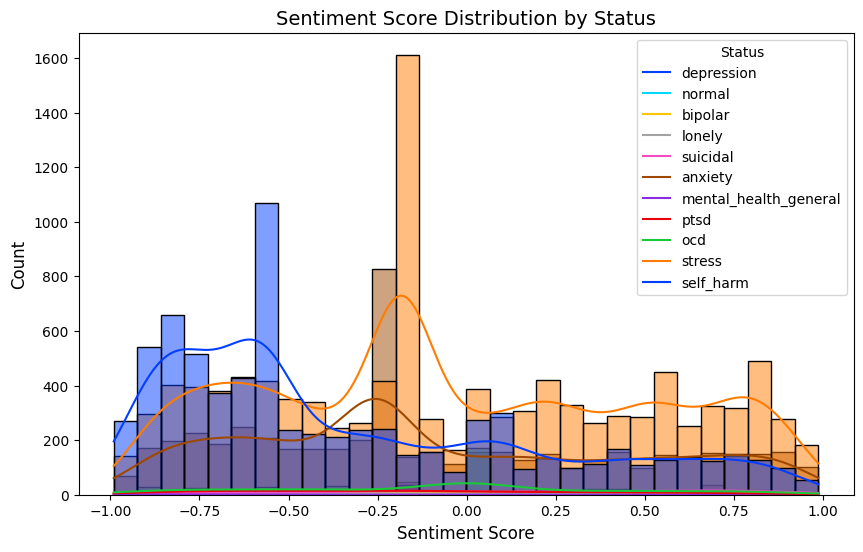

In [9]:
# Histogram
plt.figure(figsize=(10, 6))
sns.histplot(data=df, x='sentiment', hue='status', bins=30, kde=True, palette='bright')

plt.title('Sentiment Score Distribution by Status', fontsize=14)
plt.xlabel('Sentiment Score', fontsize=12)
plt.ylabel('Count', fontsize=12)
plt.legend(title='Status', labels=df['status'].unique()) 

plt.savefig('sentiment_distribution_hist.png', dpi=300, bbox_inches='tight')
plt.show()


#### Box Plot: Sentiment Spread by Status

C:\Users\Nidhi Dhameliya\AppData\Local\Temp\ipykernel_12516\1140075397.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='status', y='sentiment', data=df, palette='pastel')


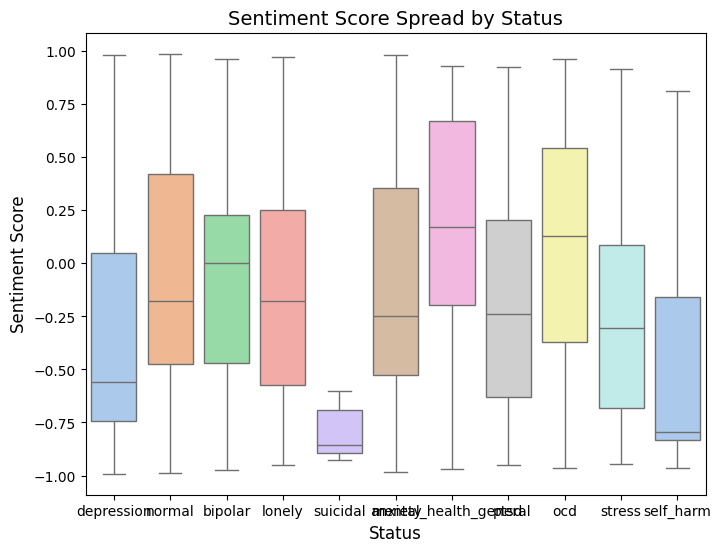

In [10]:
# Box plot
plt.figure(figsize=(8, 6))
sns.boxplot(x='status', y='sentiment', data=df, palette='pastel')
plt.title('Sentiment Score Spread by Status', fontsize=14)
plt.xlabel('Status', fontsize=12)
plt.ylabel('Sentiment Score', fontsize=12)
plt.savefig('sentiment_boxplot.png', dpi=300, bbox_inches='tight')
plt.show()

# topic modeling

In [11]:
# Preprocessing for LDA
stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()

def preprocess_for_lda(text):
    tokens = word_tokenize(text)
    tokens = [lemmatizer.lemmatize(token) for token in tokens if token not in stop_words and len(token) > 2]
    return ' '.join(tokens)

df['lda_text'] = df['clean_text'].apply(preprocess_for_lda)

# Vectorize and apply LDA
vectorizer = CountVectorizer(max_df=0.95, min_df=2, stop_words='english')
doc_term_matrix = vectorizer.fit_transform(df['lda_text'].dropna())
n_topics = 5  # Number of topics
lda = LatentDirichletAllocation(n_components=n_topics, random_state=42)
lda_output = lda.fit_transform(doc_term_matrix)

# Add dominant topic to DataFrame
df['dominant_topic'] = np.argmax(lda_output, axis=1)

# Extract top words and assign topic names (hypothetical until you run it)
feature_names = vectorizer.get_feature_names_out()
topic_names = {}
for topic_idx, topic in enumerate(lda.components_):
    top_words = [feature_names[i] for i in topic.argsort()[:-10 - 1:-1]]
    print(f"Topic {topic_idx + 1}: {', '.join(top_words)}")
    # Assign names based on top words (replace with your interpretation)
    if topic_idx == 0:
        topic_names[topic_idx] = "Loneliness"  # e.g., "sad, depression, alone"
    elif topic_idx == 1:
        topic_names[topic_idx] = "Coping via Spending"  # e.g., "buy, onlyfans, lucky"
    elif topic_idx == 2:
        topic_names[topic_idx] = "Personal Struggles"  # e.g., "suffer, suffered"
    elif topic_idx == 3:
        topic_names[topic_idx] = "Isolation"  # e.g., "quarantine, day"
    elif topic_idx == 4:
        topic_names[topic_idx] = "Media Consumption"  # e.g., "binge, watching"

# Map topic names to DataFrame
df['topic_name'] = df['dominant_topic'].map(topic_names)
df.to_csv('tweets_with_sentiment.csv', index=False)

Topic 1: anxiety, like, day, attack, ive, today, week, work, sleep, roof
Topic 2: depression, great, like, dont, people, anxiety, going, life, day, bipolar
Topic 3: anxiety, time, help, anxious, health, depression, god, mental, fear, stress
Topic 4: anxious, anxiety, know, feel, time, going, people, like, dont, thing
Topic 5: depression, que, chrome, más, los, people, quarantine, anxiety, usa, google


In [12]:
import pandas as pd

df = pd.read_csv("tweets_with_sentiment.csv")
print(df.info())
print(df.head())
print(df.isnull().sum())
print(df.describe())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25425 entries, 0 to 25424
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   date            25425 non-null  object 
 1   post_id         25425 non-null  float64
 2   username        25425 non-null  object 
 3   tweet_text      25421 non-null  object 
 4   replies         25425 non-null  int64  
 5   retweets        25425 non-null  int64  
 6   favorites       25425 non-null  int64  
 7   mentions        2420 non-null   object 
 8   hashtags        3651 non-null   object 
 9   permalink       25425 non-null  object 
 10  status          25425 non-null  object 
 11  clean_text      25413 non-null  object 
 12  sentiment       25425 non-null  float64
 13  lda_text        25395 non-null  object 
 14  dominant_topic  25425 non-null  int64  
 15  topic_name      25425 non-null  object 
dtypes: float64(2), int64(4), object(10)
memory usage: 3.1+ MB
None
             

#### Bar Chart: Top Words per Topic

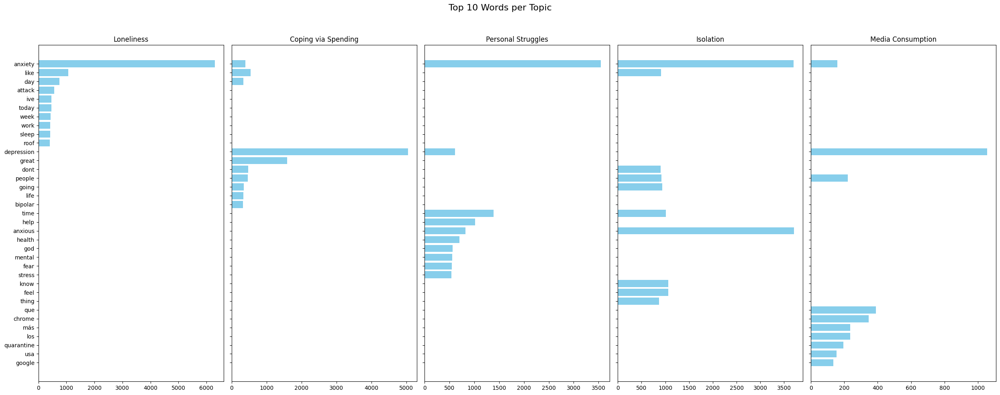

In [13]:
def plot_top_words(model, feature_names, n_top_words, topic_names):
    fig, axes = plt.subplots(1, n_topics, figsize=(25, 10), sharey=True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(model.components_):
        top_indices = topic.argsort()[:-n_top_words - 1:-1]
        top_words = [feature_names[i] for i in top_indices]
        weights = topic[top_indices]
        ax = axes[topic_idx]
        ax.barh(top_words, weights, color='skyblue')
        ax.set_title(topic_names[topic_idx], fontsize=12)  # Uses topic name
        ax.invert_yaxis()
    plt.suptitle('Top 10 Words per Topic', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.savefig('top_words_per_topic_named.png')
    plt.show()

plot_top_words(lda, feature_names, 10, topic_names)




#### . Pie Chart: Topic Distribution

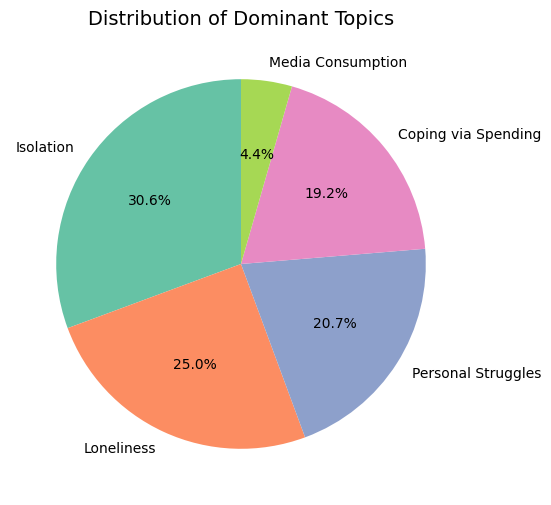

In [14]:
# Pie chart with topic names
topic_counts = df['topic_name'].value_counts()
plt.figure(figsize=(8, 6))
plt.pie(topic_counts, labels=topic_counts.index, autopct='%1.1f%%', startangle=90, 
        colors=sns.color_palette('Set2', n_topics))
plt.title('Distribution of Dominant Topics', fontsize=14)
plt.savefig('topic_distribution_named.png')
plt.show()

In [15]:
pip install wordcloud


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.0.1 -> 25.1
[notice] To update, run: python.exe -m pip install --upgrade pip


#### Word Cloud: Words by Topic

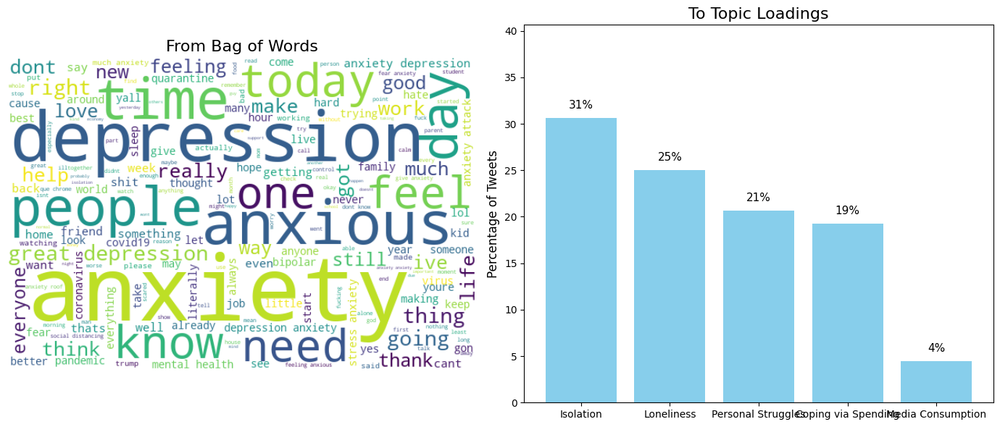

In [16]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import pandas as pd


df = pd.read_csv('tweets_with_sentiment.csv')

# 1. WORD CLOUD (Bag of Words)
# Combine all preprocessed LDA text into one big blob
text_blob = ' '.join(df['lda_text'].dropna())

# Create word cloud
wordcloud = WordCloud(width=600, height=400, background_color='white').generate(text_blob)

# 2. TOPIC LOADINGS (Bar Chart)
# Count % of tweets by topic
topic_distribution = df['topic_name'].value_counts(normalize=True).sort_values(ascending=False) * 100

# 3. Plot Side-by-Side 
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6), gridspec_kw={'width_ratios': [1, 1]})

# Left: Word Cloud
ax1.imshow(wordcloud, interpolation='bilinear')
ax1.axis('off')
ax1.set_title("From Bag of Words", fontsize=16)

# Right: Topic Loadings
bars = ax2.bar(topic_distribution.index, topic_distribution.values, color='skyblue')
ax2.set_ylim(0, topic_distribution.values.max() + 10)
ax2.set_ylabel("Percentage of Tweets", fontsize=12)
ax2.set_title("To Topic Loadings", fontsize=16)

# Add % labels above bars
for bar in bars:
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2, height + 1, f"{height:.0f}%", ha='center', fontsize=11)

plt.tight_layout()
plt.show()


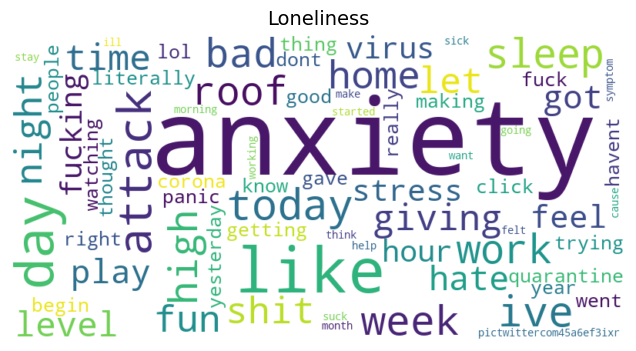

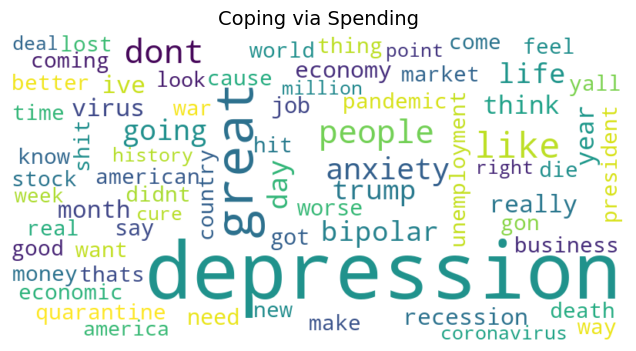

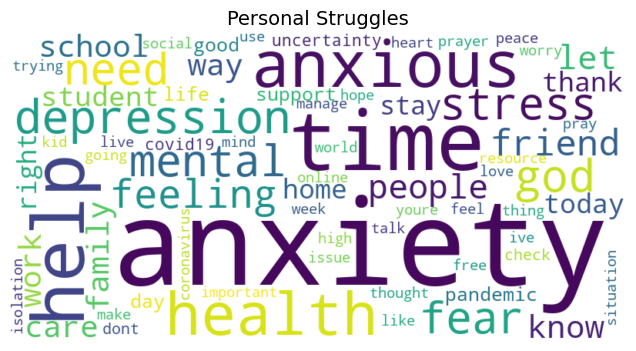

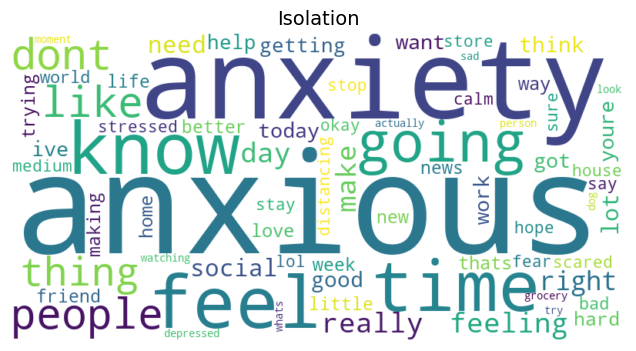

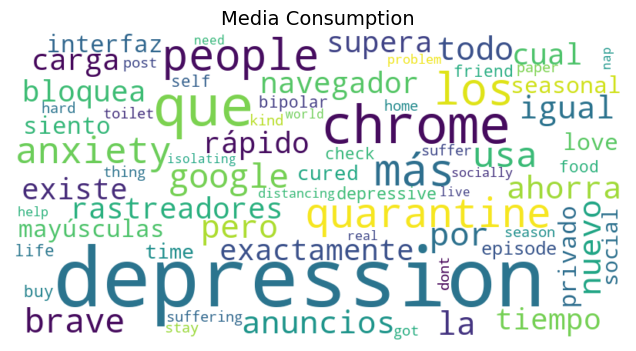

In [17]:
from wordcloud import WordCloud


for topic_idx in range(n_topics):
    # Extract top 10 words and their weights for this topic
    top_indices = lda.components_[topic_idx].argsort()[:-70 - 1:-1]  # Top 10 indices in descending order
    top_words = {feature_names[i]: lda.components_[topic_idx][i] for i in top_indices}  # Dictionary of word:weight
    # Generate word cloud using weights
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(top_words)
    plt.figure(figsize=(8, 4))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'{topic_names[topic_idx]}', fontsize=14)  # Use topic name
    plt.savefig(f'{topic_names[topic_idx].lower().replace(" ", "_")}_wordcloud.png')
    plt.show()

# correlation analysis

Correlation Matrix:
           sentiment   replies  retweets  favorites
sentiment   1.000000  0.016789  0.052104   0.045798
replies     0.016789  1.000000  0.236263   0.400875
retweets    0.052104  0.236263  1.000000   0.494327
favorites   0.045798  0.400875  0.494327   1.000000


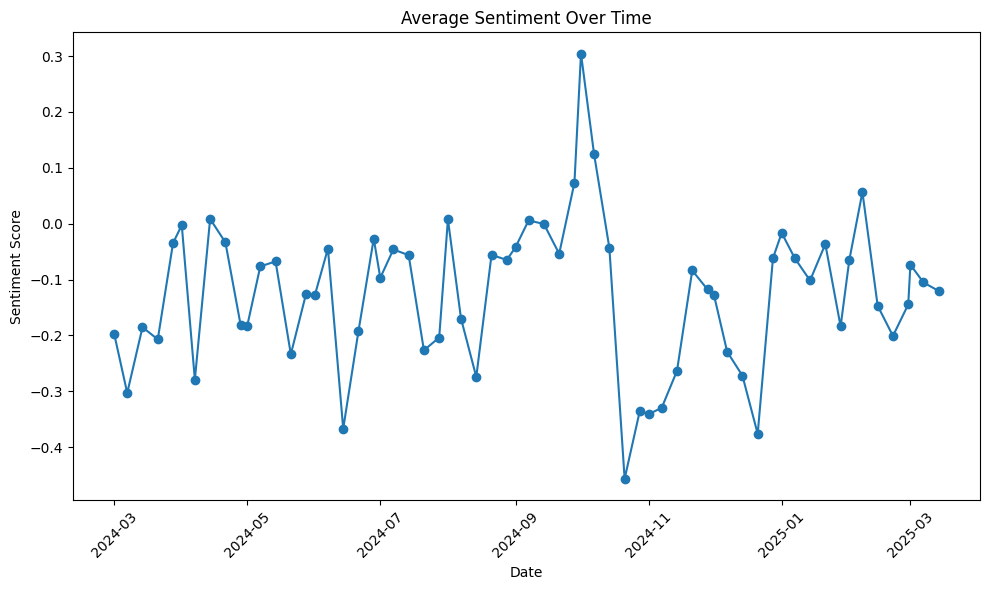

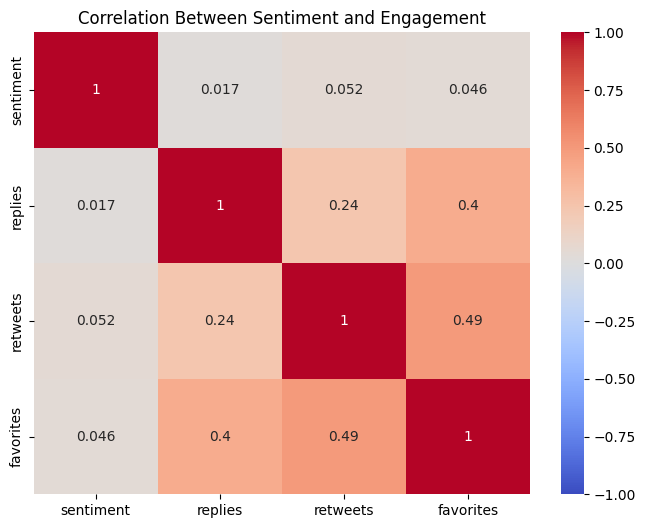

In [18]:
# Convert date to datetime
df['date'] = pd.to_datetime(df['date'], format='%d-%m-%Y %H:%M')

# Aggregate sentiment by date (daily)
daily_sentiment = df.groupby(df['date'].dt.date)['sentiment'].mean().reset_index()

# Plot sentiment over time
plt.figure(figsize=(10, 6))
plt.plot(daily_sentiment['date'], daily_sentiment['sentiment'], marker='o')
plt.title('Average Sentiment Over Time')
plt.xlabel('Date')
plt.ylabel('Sentiment Score')
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('sentiment_over_time.png')

# Correlation between sentiment and engagement
correlation_matrix = df[['sentiment', 'replies', 'retweets', 'favorites']].corr(method='spearman')
print("Correlation Matrix:")
print(correlation_matrix)

# Heatmap of correlations
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Between Sentiment and Engagement')
plt.savefig('correlation_heatmap.png')

## model training


Logistic Regression
              precision    recall  f1-score   support

    Negative       0.85      0.93      0.89      3085
     Neutral       0.82      0.15      0.26       238
    Positive       0.83      0.78      0.80      1760

    accuracy                           0.84      5083
   macro avg       0.83      0.62      0.65      5083
weighted avg       0.84      0.84      0.83      5083



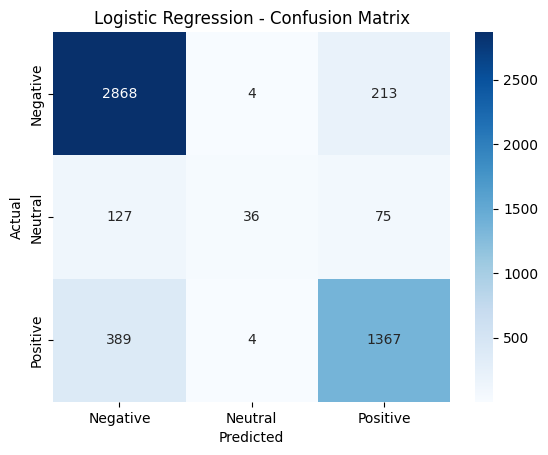


Naive Bayes
              precision    recall  f1-score   support

    Negative       0.73      0.96      0.83      3085
     Neutral       0.88      0.03      0.06       238
    Positive       0.83      0.48      0.61      1760

    accuracy                           0.75      5083
   macro avg       0.81      0.49      0.50      5083
weighted avg       0.77      0.75      0.71      5083



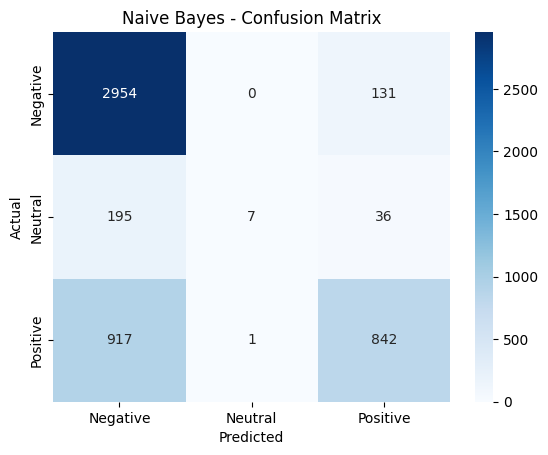


SVM


C:\Users\Nidhi Dhameliya\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


              precision    recall  f1-score   support

    Negative       0.86      0.91      0.88      3085
     Neutral       0.60      0.20      0.30       238
    Positive       0.81      0.80      0.80      1760

    accuracy                           0.84      5083
   macro avg       0.76      0.64      0.66      5083
weighted avg       0.83      0.84      0.83      5083



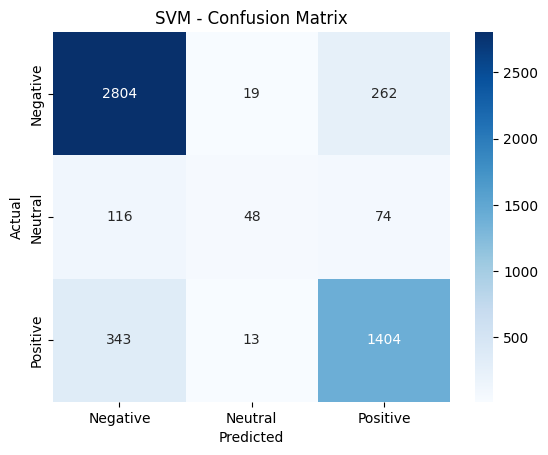


Random Forest
              precision    recall  f1-score   support

    Negative       0.85      0.88      0.86      3085
     Neutral       0.73      0.42      0.53       238
    Positive       0.76      0.75      0.75      1760

    accuracy                           0.81      5083
   macro avg       0.78      0.68      0.72      5083
weighted avg       0.81      0.81      0.81      5083



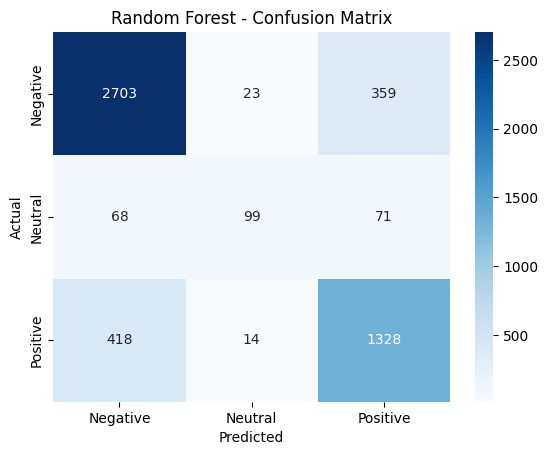

In [19]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Load dataset
df = pd.read_csv("tweets_with_sentiment.csv") 

# Drop missing clean_text or sentiment
df = df.dropna(subset=['clean_text', 'sentiment'])

# Map sentiment to labels
def map_sentiment(value):
    if value < -0.05:
        return 'Negative'
    elif value > 0.05:
        return 'Positive'
    else:
        return 'Neutral'

df['sentiment_label'] = df['sentiment'].apply(map_sentiment)

# Vectorize text using TF-IDF
tfidf = TfidfVectorizer(max_features=5000, stop_words='english')
X = tfidf.fit_transform(df['clean_text'])

y = df['sentiment_label']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Models
models = {
    'Logistic Regression': LogisticRegression(max_iter=1000),
    'Naive Bayes': MultinomialNB(),
    'SVM': LinearSVC(),
    'Random Forest': RandomForestClassifier(n_estimators=100)
}

# Train and evaluate
for name, model in models.items():
    print(f"\n{name}")
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    print(classification_report(y_test, y_pred))
    
    # Confusion Matrix
    cm = confusion_matrix(y_test, y_pred, labels=['Negative', 'Neutral', 'Positive'])
    sns.heatmap(cm, annot=True, fmt='d', xticklabels=['Negative', 'Neutral', 'Positive'],
                yticklabels=['Negative', 'Neutral', 'Positive'], cmap='Blues')
    plt.title(f"{name} - Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()


In [20]:
import joblib

# Save
joblib.dump(models['SVM'], 'svm_sentiment_model.pkl')

# Load later
svm_model = joblib.load('svm_sentiment_model.pkl')

joblib.dump(tfidf, 'tfidf_vectorizer.pkl')


['tfidf_vectorizer.pkl']

# Predict Mental Health Trends

Loaded models:
TF-IDF Vectorizer: <class 'sklearn.feature_extraction.text.TfidfVectorizer'>
SVM Model: <class 'sklearn.svm._classes.LinearSVC'>

Model Evaluation:
              precision    recall  f1-score   support

    Negative       0.91      0.95      0.93     15341
     Neutral       0.91      0.39      0.54      1111
    Positive       0.89      0.89      0.89      8961

    accuracy                           0.90     25413
   macro avg       0.91      0.74      0.79     25413
weighted avg       0.90      0.90      0.90     25413


Forecast plot saved as sentiment_forecast.png


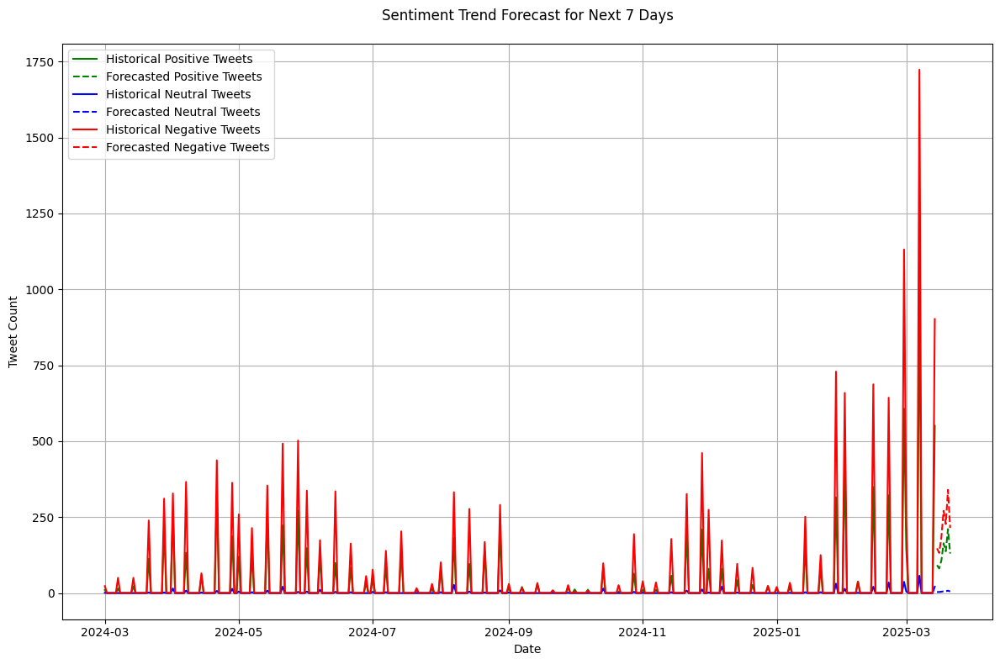

Results saved to tweets_with_sentiment.csv


In [21]:
import pandas as pd
import joblib
from sklearn.feature_extraction.text import TfidfVectorizer
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report

# 1. Load and preprocess data
df = pd.read_csv("tweets_with_sentiment.csv")

# Drop rows with missing values
df = df.dropna(subset=['clean_text', 'sentiment', 'date'])

# Convert date column to datetime format
df['date'] = pd.to_datetime(df['date'], format='%d-%m-%Y %H:%M', errors='coerce')
df = df.dropna(subset=['date'])

# 2. Load pre-trained models
try:
    # Load the TF-IDF vectorizer and SVM model
    tfidf = joblib.load('tfidf_vectorizer.pkl')
    svm_model = joblib.load('svm_sentiment_model.pkl')
    
    # Verify model classes
    print("Loaded models:")
    print(f"TF-IDF Vectorizer: {type(tfidf)}")
    print(f"SVM Model: {type(svm_model)}")
except Exception as e:
    print(f"Error loading models: {e}")
    raise

# 3. Transform text data and predict sentiment
try:
    X = tfidf.transform(df['clean_text'])
    df['predicted_sentiment'] = svm_model.predict(X)
    
    # Map sentiment scores to labels for comparison
    def map_sentiment(value):
        if value < -0.05:
            return 'Negative'
        elif value > 0.05:
            return 'Positive'
        else:
            return 'Neutral'
    
    df['actual_sentiment'] = df['sentiment'].apply(map_sentiment)
    
    # Evaluate model performance
    print("\nModel Evaluation:")
    print(classification_report(df['actual_sentiment'], df['predicted_sentiment']))
except Exception as e:
    print(f"Error during prediction: {e}")
    raise

# 4. Prepare time series data
daily_sentiment = df.groupby(['date', 'predicted_sentiment']).size().unstack().fillna(0)
daily_sentiment = daily_sentiment.resample('D').sum()

# 5. Forecasting for each sentiment class
plt.figure(figsize=(12, 8))

sentiment_colors = {
    'Positive': 'green',
    'Neutral': 'blue',
    'Negative': 'red'
}

for sentiment in ['Positive', 'Neutral', 'Negative']:
    if sentiment in daily_sentiment.columns:
        ts = daily_sentiment[sentiment]
        
        # ARIMA Forecasting (simple configuration - adjust as needed)
        try:
            model = ARIMA(ts, order=(5, 1, 0))
            model_fit = model.fit()
            forecast = model_fit.forecast(steps=7)  # 7-day forecast
            
            # Plot results
            plt.plot(ts, label=f'Historical {sentiment} Tweets', color=sentiment_colors[sentiment])
            plt.plot(forecast.index, forecast, 
                    label=f'Forecasted {sentiment} Tweets', 
                    linestyle='--', 
                    color=sentiment_colors[sentiment])
        except Exception as e:
            print(f"Error forecasting {sentiment} tweets: {e}")

# 6. Finalize and save plot
plt.title("Sentiment Trend Forecast for Next 7 Days", pad=20)
plt.xlabel("Date")
plt.ylabel("Tweet Count")
plt.legend()
plt.grid(True)
plt.tight_layout()

# Save the plot
plot_filename = 'sentiment_forecast.png'
plt.savefig(plot_filename, dpi=300)
print(f"\nForecast plot saved as {plot_filename}")

# Show the plot
plt.show()

# 7. Save results with predictions
output_filename = 'tweets_with_sentiment.csv'
df.to_csv(output_filename, index=False)
print(f"Results saved to {output_filename}")

##### forecast sentiment trends using ARIMA.

In [22]:
!pip install pmdarima



[notice] A new release of pip is available: 25.0.1 -> 25.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Final shape after cleaning: (379,)
date
2024-03-01 23:55:00   -0.196897
2024-03-02 23:55:00   -0.196897
2024-03-03 23:55:00   -0.196897
2024-03-04 23:55:00   -0.196897
2024-03-05 23:55:00   -0.196897
Freq: D, Name: sentiment, dtype: float64
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-1096.833, Time=0.11 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-199.412, Time=0.08 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-1098.562, Time=0.09 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-569.254, Time=0.35 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-1096.847, Time=0.28 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-1094.568, Time=0.52 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-1106.260, Time=0.21 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=-443.094, Time=0.15 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-1105.222, Time=0.15 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-1105.136, Time=0.59 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-762.51

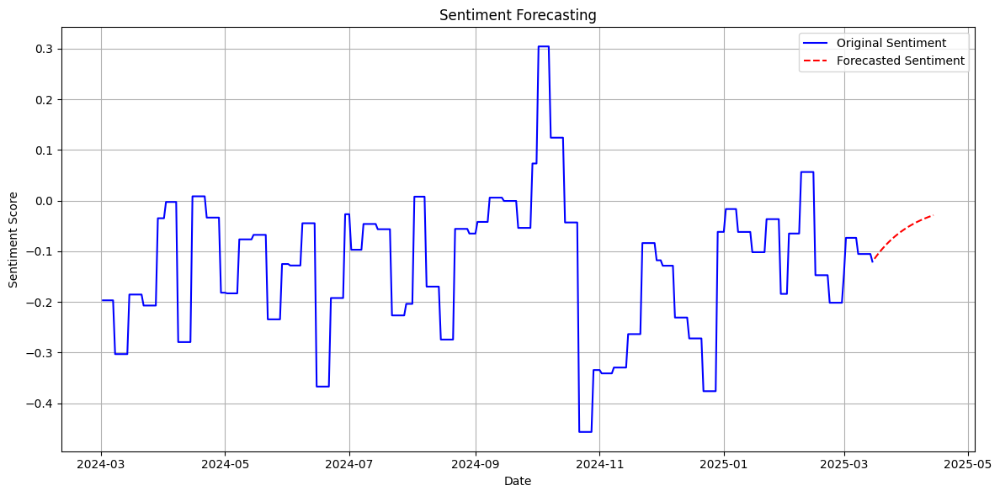

2025-03-15 23:55:00   -0.114804
2025-03-16 23:55:00   -0.109345
2025-03-17 23:55:00   -0.104157
2025-03-18 23:55:00   -0.099227
2025-03-19 23:55:00   -0.094539
Freq: D, dtype: float64


In [23]:
import warnings
import pandas as pd
import numpy as np
from statsmodels.tsa.statespace.sarimax import SARIMAX
from pmdarima.arima import auto_arima
import matplotlib.pyplot as plt

# Suppress warnings
warnings.filterwarnings("ignore")

#  Load the dataset
df = pd.read_csv("tweets_with_sentiment.csv")

# Convert 'date' to datetime
df['date'] = pd.to_datetime(df['date'], errors='coerce')

# Drop missing dates or sentiment values
df = df.dropna(subset=['date', 'sentiment'])

#  Average daily sentiment
daily_sentiment = df.groupby('date')['sentiment'].mean()

# Reindex to daily frequency, fill gaps
daily_sentiment = daily_sentiment.asfreq('D').ffill()

# Debug shape
print("Final shape after cleaning:", daily_sentiment.shape)
print(daily_sentiment.head())

#  Auto ARIMA to find best params
model = auto_arima(
    daily_sentiment,
    start_p=1, start_q=1,
    max_p=3, max_q=3,
    seasonal=False,
    stepwise=True,
    trace=True,
    suppress_warnings=True,
    error_action='ignore'
)

# Fit SARIMAX model
best_model = SARIMAX(daily_sentiment, order=model.order)
result = best_model.fit()

# Forecast next 30 days with proper datetime index
forecast_values = result.predict(start=len(daily_sentiment), end=len(daily_sentiment) + 29)
forecast_index = pd.date_range(start=daily_sentiment.index[-1] + pd.Timedelta(days=1), periods=30, freq='D')
forecast_series = pd.Series(forecast_values.values, index=forecast_index)

#Plot
plt.figure(figsize=(12, 6))
plt.plot(daily_sentiment, label='Original Sentiment', color='blue')
plt.plot(forecast_series, label='Forecasted Sentiment', color='red', linestyle='--')
plt.title('Sentiment Forecasting')
plt.xlabel('Date')
plt.ylabel('Sentiment Score')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig('sentiment_forecast_auto_arima.png')
plt.show()

# Optional: Show forecasted values
print(forecast_series.head())


#### Topic Prevalence Forecast (Date-Limited Data)
Since your sample shows a single date, let’s forecast the prevalence of mental health topics (e.g., "Loneliness," "Isolation") over a hypothetical future period

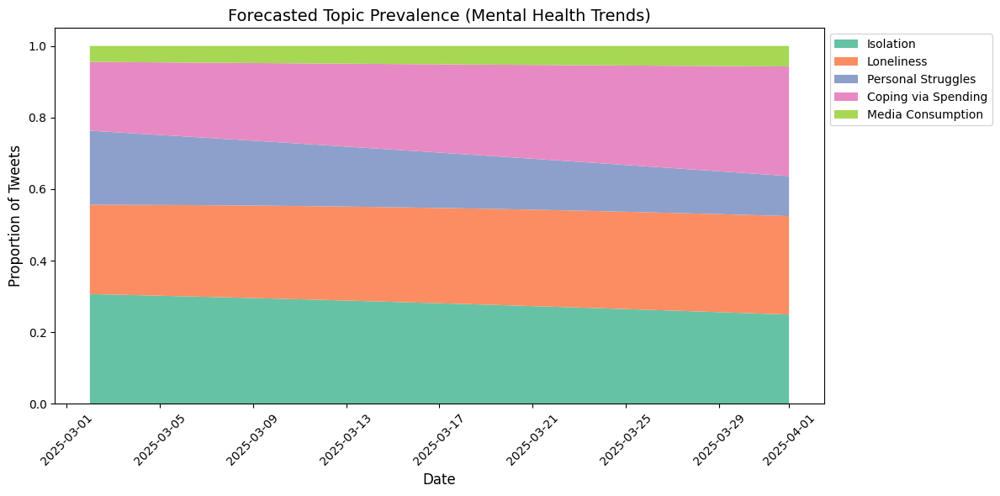

Isolation              0.249347
Loneliness             0.275071
Personal Struggles     0.111910
Coping via Spending    0.306292
Media Consumption      0.057380
Name: 2025-04-01 00:00:00, dtype: float64


In [24]:

topic_counts = df['topic_name'].value_counts().reset_index()
topic_counts.columns = ['topic_name', 'count']
topic_counts['proportion'] = topic_counts['count'] / len(df)
topic_sentiment = df.groupby('topic_name')['sentiment'].mean().reset_index()
topic_data = topic_counts.merge(topic_sentiment, on='topic_name')
topic_data['growth_rate'] = -topic_data['sentiment'] * 0.1

forecast = {t: [p * (1 + g) ** i for i in range(31)] for t, p, g in zip(topic_data['topic_name'], topic_data['proportion'], topic_data['growth_rate'])}
forecast_df = pd.DataFrame(forecast, index=pd.date_range(start='2025-03-02', periods=31, freq='D'))
forecast_df = forecast_df.div(forecast_df.sum(axis=1), axis=0)

plt.figure(figsize=(12, 6))
plt.stackplot(forecast_df.index, forecast_df.T, labels=forecast_df.columns, colors=sns.color_palette('Set2', n_colors=len(forecast_df.columns)))
plt.title('Forecasted Topic Prevalence (Mental Health Trends)', fontsize=14)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Proportion of Tweets', fontsize=12)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('topic_prevalence_forecast.png')
plt.show()

print(forecast_df.iloc[-1])


# Visualize Trends

In [25]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

#  the dataset with sentiment and topics
df = pd.read_csv('tweets_with_sentiment.csv')

# Convert 'date' to datetime
df['date'] = pd.to_datetime(df['date'], format='%Y-%m-%d %H:%M:%S')

# Check unique dates
unique_dates = df['date'].dt.date.nunique()
print(f"Number of unique dates: {unique_dates}")

Number of unique dates: 63


# Visualization 1: Interactive Sentiment Trends
### 1. Line Chart (If Dates Vary)

In [26]:
# Convert 'date' column to datetime
df['date'] = pd.to_datetime(df['date'])

# Aggregate daily sentiment by status
daily_sentiment = df.groupby([df['date'].dt.date, 'status'])['sentiment'].mean().reset_index()
daily_sentiment['date'] = pd.to_datetime(daily_sentiment['date'])

# Interactive line chart
fig = px.line(daily_sentiment, x='date', y='sentiment', color='status',
              title='Sentiment Trends Over Time by Status',
              labels={'sentiment': 'Sentiment Score (-1 to +1)', 'date': 'Date'},
              hover_data={'status': True, 'sentiment': ':.2f'})

# Update layout for interactivity
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Sentiment Score",
    legend_title="Status",
    hovermode="x unified",
    template="plotly_white"
)

# Add range slider and buttons
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=True),
        type="date"
    )
)

fig.write_html("sentiment_trends.html")
fig.show()


### B: Box Plot (If Dates Are Fixed)

In [27]:
# Interactive box plot
fig = px.box(df, x='topic_name', y='sentiment', color='status',
             title='Sentiment Distribution by Topic and Status',
             labels={'sentiment': 'Sentiment Score (-1 to +1)', 'topic_name': 'Topic'},
             hover_data={'sentiment': True, 'status': True})

# Update layout
fig.update_layout(
    xaxis_title="Topic",
    yaxis_title="Sentiment Score",
    legend_title="Status",
    boxmode='group',  # Group boxes by topic
    template="plotly_white"
)

fig.write_html("sentiment_box.html")
fig.show()

# visualization 2: Interactive Topic Prevalence Trends
### A: Stacked Area Chart (Simulated Trend)

In [28]:
# Current topic proportions
topic_counts = df['topic_name'].value_counts().reset_index()
topic_counts.columns = ['topic_name', 'count']
total_tweets = len(df)
topic_counts['proportion'] = topic_counts['count'] / total_tweets

# Add sentiment per topic
topic_sentiment = df.groupby('topic_name')['sentiment'].mean().reset_index()
topic_data = topic_counts.merge(topic_sentiment, on='topic_name')

# Simulate growth: more negative sentiment = higher growth
topic_data['growth_rate'] = -topic_data['sentiment'] * 0.1  # Adjust scale as needed

# Forecast 30 days
forecast_days = 30
forecast_data = {}
for topic in topic_data['topic_name']:
    initial_prop = topic_data.loc[topic_data['topic_name'] == topic, 'proportion'].values[0]
    growth_rate = topic_data.loc[topic_data['topic_name'] == topic, 'growth_rate'].values[0]
    forecast = [initial_prop * (1 + growth_rate) ** t for t in range(forecast_days + 1)]
    forecast_data[topic] = forecast

# Create DataFrame with dates
forecast_df = pd.DataFrame(forecast_data, 
                          index=pd.date_range(start='2024-03-02', periods=forecast_days + 1, freq='D'))
forecast_df = forecast_df.div(forecast_df.sum(axis=1), axis=0)  # Normalize to 1

# Convert to long format for Plotly
forecast_long = forecast_df.reset_index().melt(id_vars=['index'], var_name='topic_name', value_name='proportion')

# Interactive stacked area chart
fig = px.area(forecast_long, x='index', y='proportion', color='topic_name',
              title='Forecasted Topic Prevalence Over 30 Days',
              labels={'proportion': 'Proportion of Tweets', 'index': 'Date'},
              hover_data={'proportion': ':.3f', 'topic_name': True})

# Update layout
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Proportion",
    legend_title="Topic",
    hovermode="x unified",
    template="plotly_white",
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(count=14, label="2w", step="day", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=True),
        type="date"
    )
)

fig.write_html("topic_prevalence_trends.html")
fig.show()